In [5]:
from original_utils import PreProcessing

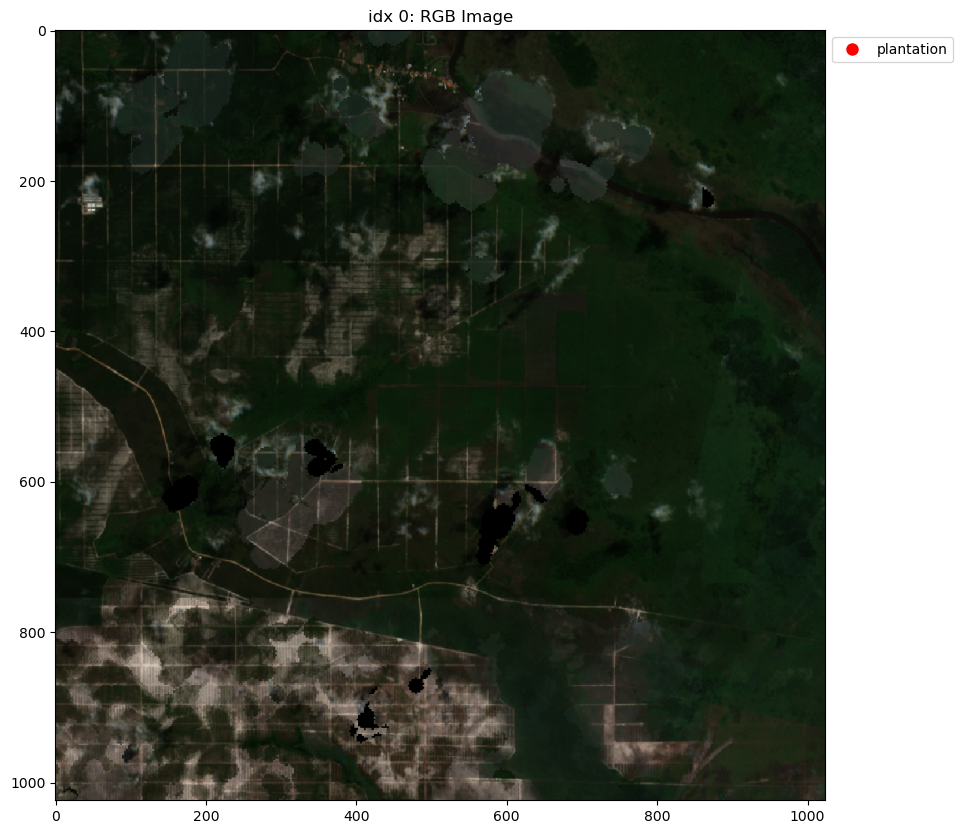

In [2]:
preprocessor = PreProcessing(train_set=True, satlas=True, img_labels=False)
preprocessor.visualize_in_RGB(start=0, n=1, annotation=False)

We see that the images contain NaN values, this needs to be handled. 

Now we want to examine how the different classes look like. 

Generating rasterized masks...
Searching for images containing class 'plantation'...
Found class in image: train_0.tif
Found class in image: train_1.tif
Found class in image: train_4.tif
Found class in image: train_5.tif
Found class in image: train_6.tif
Found class in image: train_8.tif
Found class in image: train_12.tif
Found class in image: train_14.tif
Found class in image: train_15.tif
Found class in image: train_16.tif
Displaying 10 images with class 'plantation'...


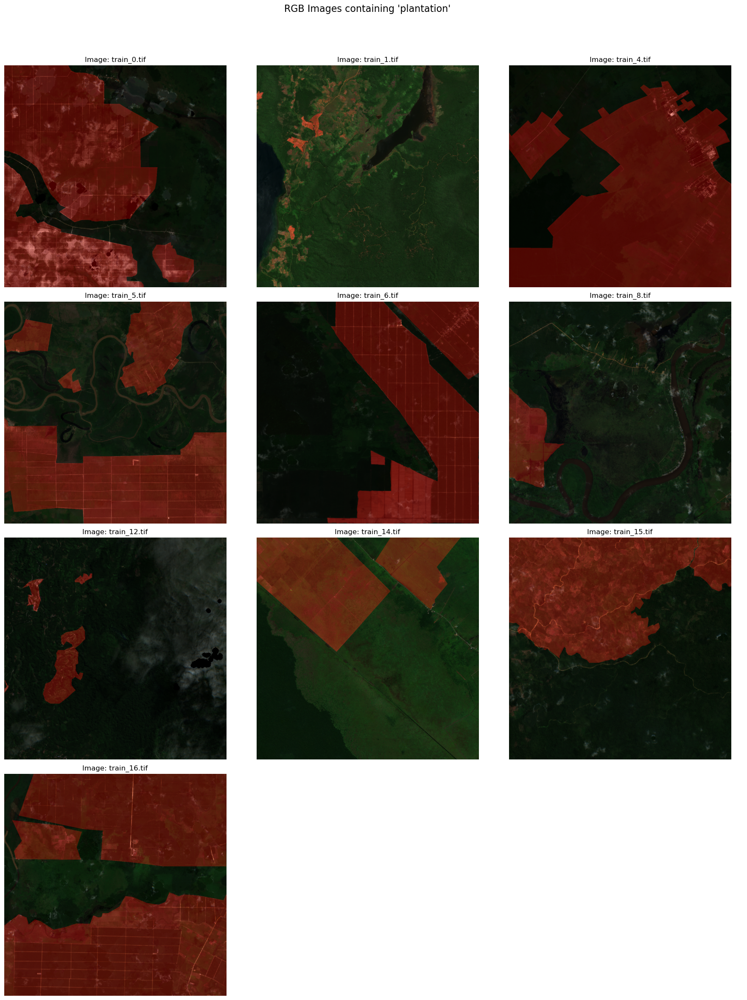

In [16]:
preprocessor.visualize_rgb_by_class(class_label="plantation", show_overlay=True)

Generating rasterized masks...
Searching for images containing class 'grassland_shrubland'...
Found class in image: train_1.tif
Found class in image: train_2.tif
Found class in image: train_3.tif
Found class in image: train_5.tif
Found class in image: train_6.tif
Found class in image: train_7.tif
Found class in image: train_8.tif
Found class in image: train_9.tif
Found class in image: train_10.tif
Found class in image: train_11.tif
Displaying 10 images with class 'grassland_shrubland'...


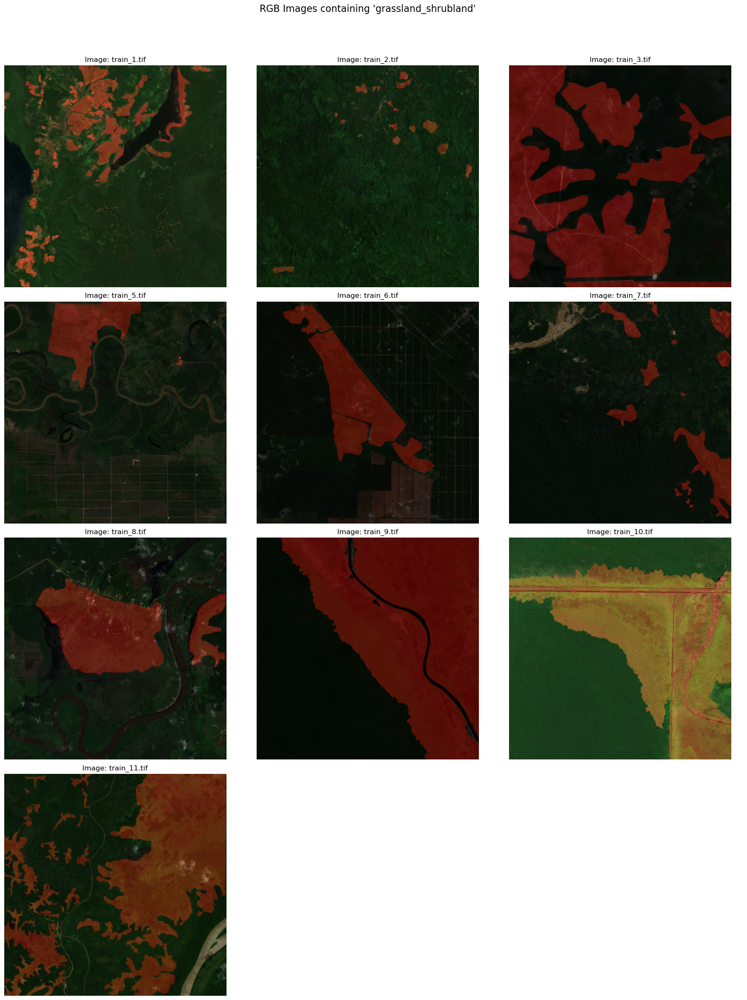

In [17]:
preprocessor.visualize_rgb_by_class(class_label="grassland_shrubland", show_overlay=True)

Generating rasterized masks...
Searching for images containing class 'mining'...
Found class in image: train_1.tif
Found class in image: train_7.tif
Found class in image: train_31.tif
Found class in image: train_39.tif
Found class in image: train_45.tif
Found class in image: train_48.tif
Found class in image: train_51.tif
Found class in image: train_57.tif
Found class in image: train_60.tif
Found class in image: train_61.tif
Displaying 10 images with class 'mining'...


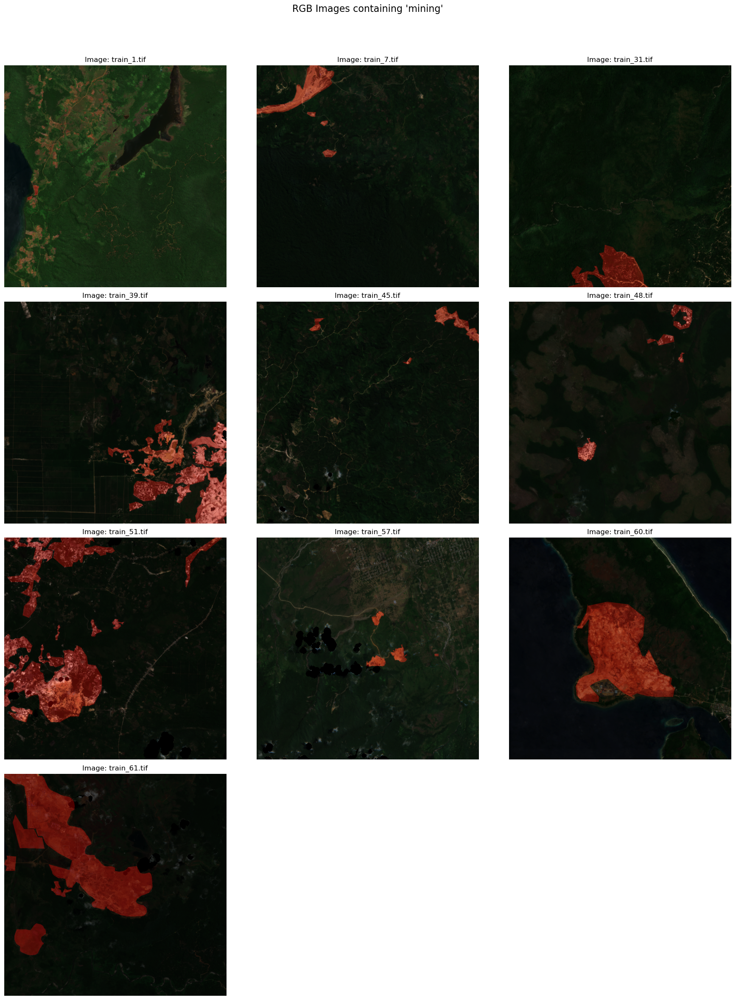

In [18]:
preprocessor.visualize_rgb_by_class(class_label="mining", show_overlay=True)

Generating rasterized masks...
Searching for images containing class 'logging'...
Found class in image: train_1.tif
Found class in image: train_2.tif
Found class in image: train_5.tif
Found class in image: train_8.tif
Found class in image: train_23.tif
Found class in image: train_25.tif
Found class in image: train_31.tif
Found class in image: train_34.tif
Found class in image: train_36.tif
Found class in image: train_37.tif
Displaying 10 images with class 'logging'...


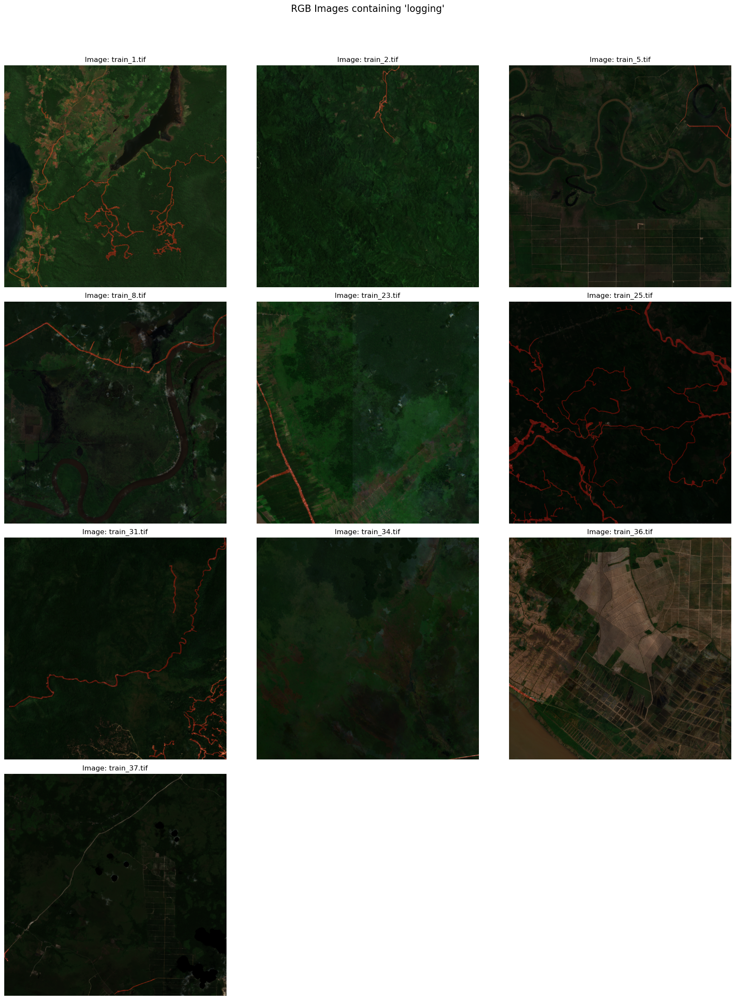

In [19]:
preprocessor.visualize_rgb_by_class(class_label="logging", show_overlay=True)

We see that logging usually has a road-like form to them. This will be more challenging to finely segment than the other classes. We now want to examine the distribution of the classes

Analyzing class distribution across 176 images...

=== Class Distribution by Image Frequency ===
Total images analyzed: 176
              Class  Images  Percentage
         background     176  100.000000
         plantation     124   70.454545
grassland_shrubland     113   64.204545
            logging      58   32.954545
             mining      47   26.704545

=== Class Distribution by Area (Pixels) ===
Total pixels analyzed: 184549376
              Class    Pixels  Percentage
         background 102254817   55.407837
         plantation  54118937   29.324909
grassland_shrubland  20568472   11.145241
             mining   6682599    3.621036
            logging    924551    0.500978


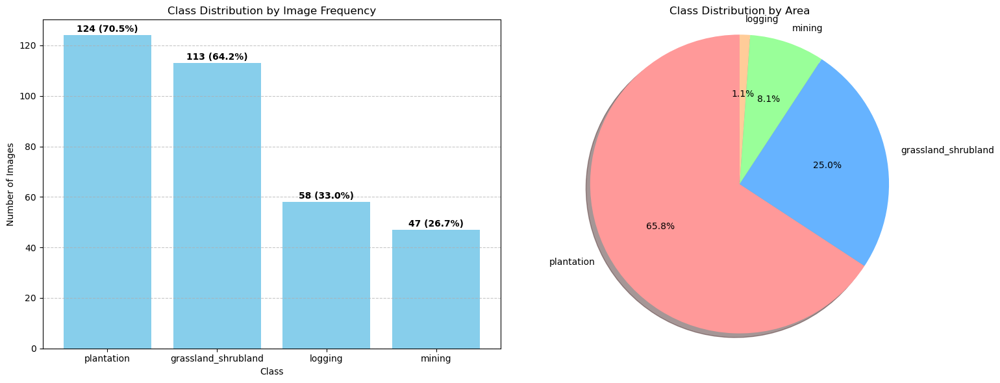


=== Class Balance Statistics (excluding background) ===
Mean class area: 11.15%
Standard deviation: 12.92%
Max/Min ratio: 58.54
⚠️ Warning: Dataset shows significant class imbalance (max/min ratio > 10)


(                 Class  Images  Percentage
 0           background     176  100.000000
 1           plantation     124   70.454545
 2  grassland_shrubland     113   64.204545
 4              logging      58   32.954545
 3               mining      47   26.704545,
                  Class     Pixels  Percentage
 0           background  102254817   55.407837
 1           plantation   54118937   29.324909
 2  grassland_shrubland   20568472   11.145241
 3               mining    6682599    3.621036
 4              logging     924551    0.500978)

In [20]:
preprocessor.analyze_class_distribution()

The dataset is heavily imbalanced. We should adopt a loss function in training that is robust to class imbalance.  

Now some sanity checks. We are doing semantic segmentation, so we are rasterizing the annotations. Check that the polygons correspond to the rastered images

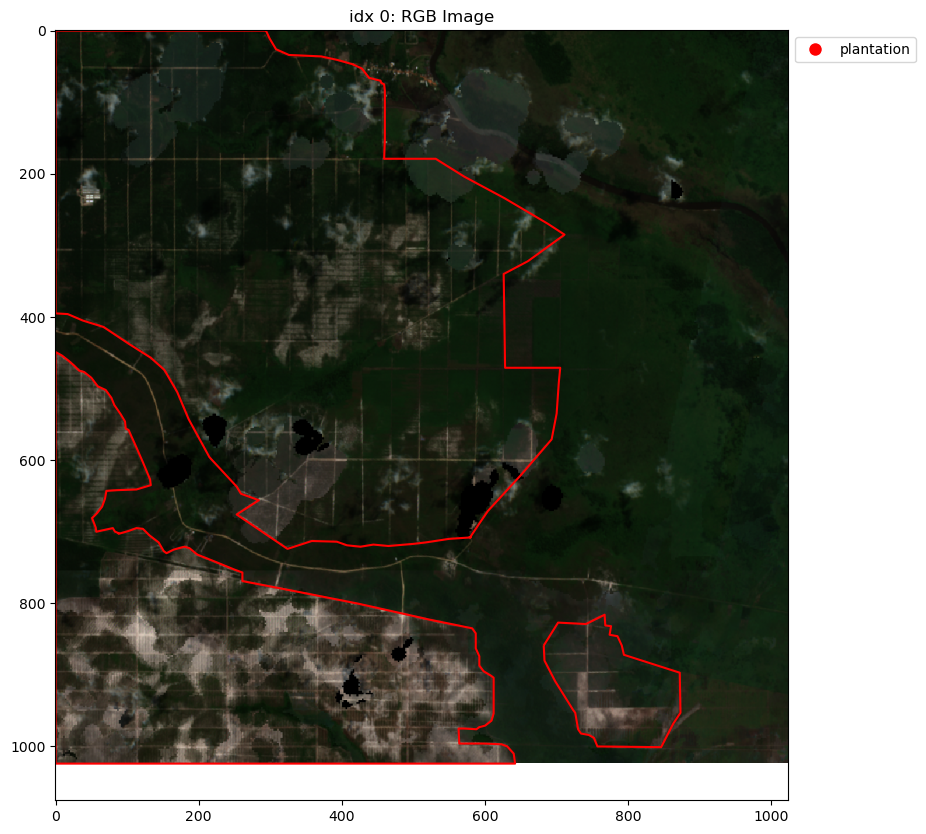

In [21]:
preprocessor.visualize_in_RGB(start=0, n=1, annotation=True)

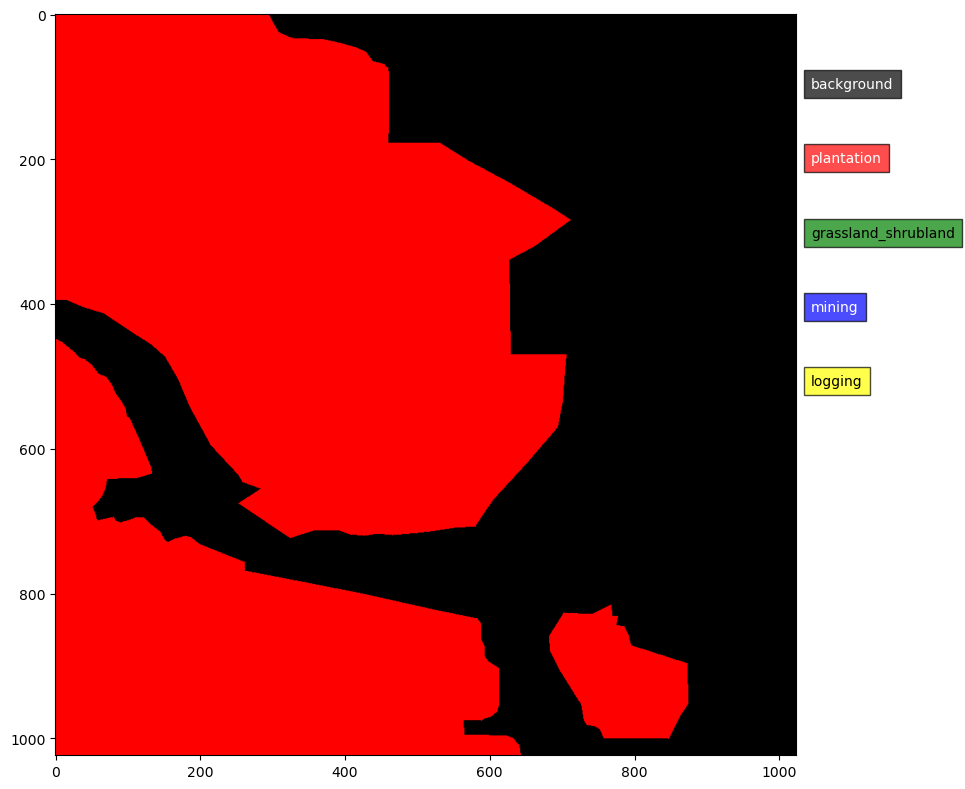

In [22]:
preprocessor.visualize_rasterized(start=0, n=1)

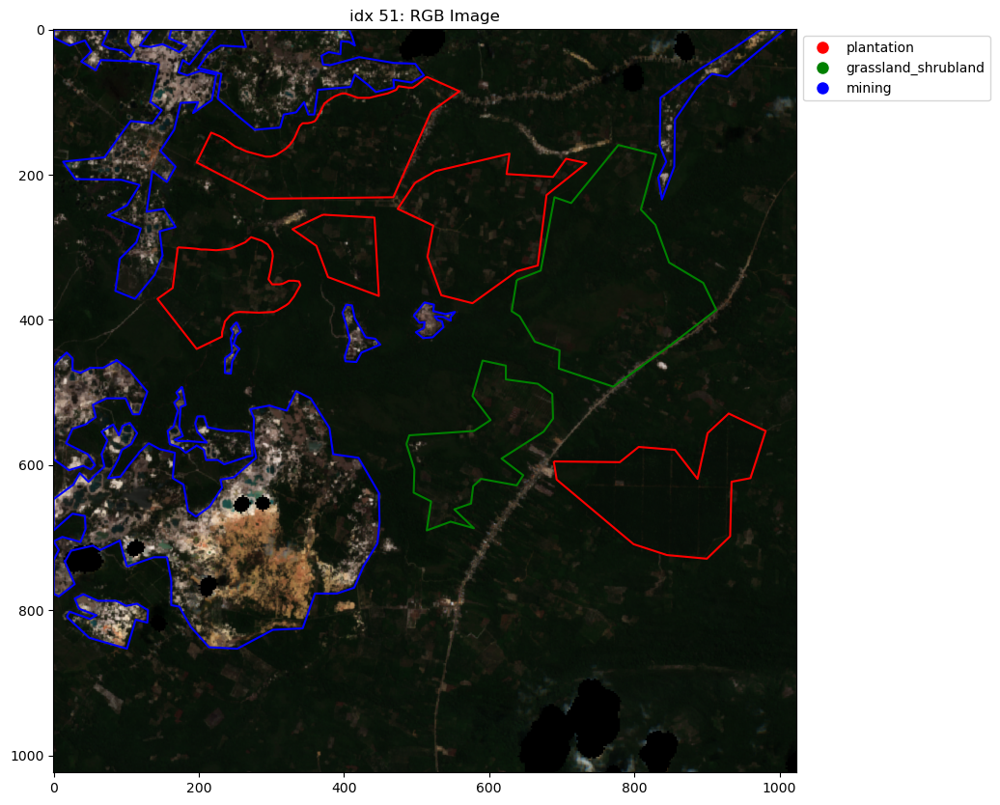

In [23]:
preprocessor.visualize_in_RGB(start=51, n=52, annotation=True)

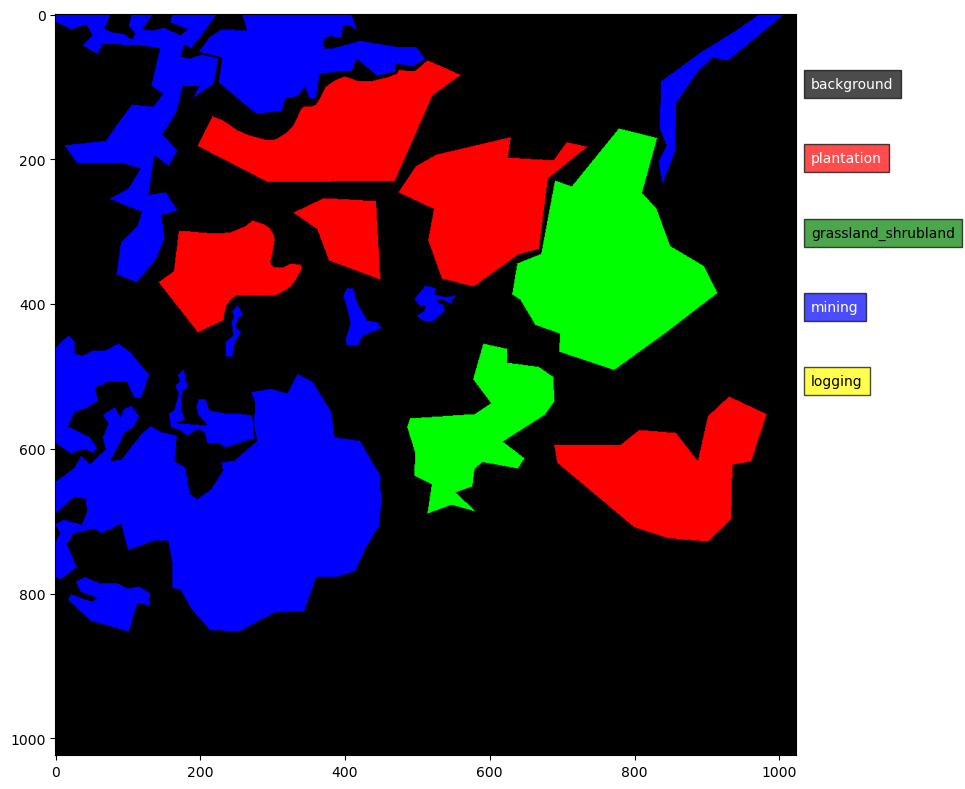

In [24]:
preprocessor.visualize_rasterized(start=51, n=52)

Now we process the data and save:
- fill nan values with cv2 method
- rasterize annotations to get pixel labels
- normalize data in accordance with satlaspretrain

In [25]:
preprocessor.preprocess()
preprocessor.save_preprocessed()

Processing train_0.tif
Processing train_1.tif
Processing train_2.tif
Processing train_3.tif
Processing train_4.tif
Processing train_5.tif
Processing train_6.tif
Processing train_7.tif
Processing train_8.tif
Processing train_9.tif
Processing train_10.tif
Processing train_11.tif
Processing train_12.tif
Processing train_13.tif
Processing train_14.tif
Processing train_15.tif
Processing train_16.tif
Processing train_17.tif
Processing train_18.tif
Processing train_19.tif
Processing train_20.tif
Processing train_21.tif
Processing train_22.tif
Processing train_23.tif
Processing train_24.tif
Processing train_25.tif
Processing train_26.tif
Processing train_27.tif
Processing train_28.tif
Processing train_29.tif
Processing train_30.tif
Processing train_31.tif
Processing train_32.tif
Processing train_33.tif
Processing train_34.tif
Processing train_35.tif
Processing train_36.tif
Processing train_37.tif
Processing train_38.tif
Processing train_39.tif
Processing train_40.tif
Processing train_41.tif
Pr

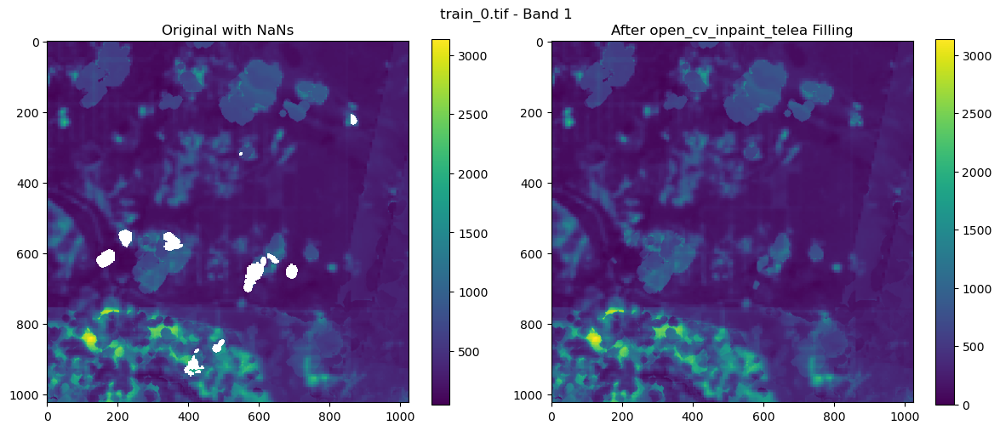

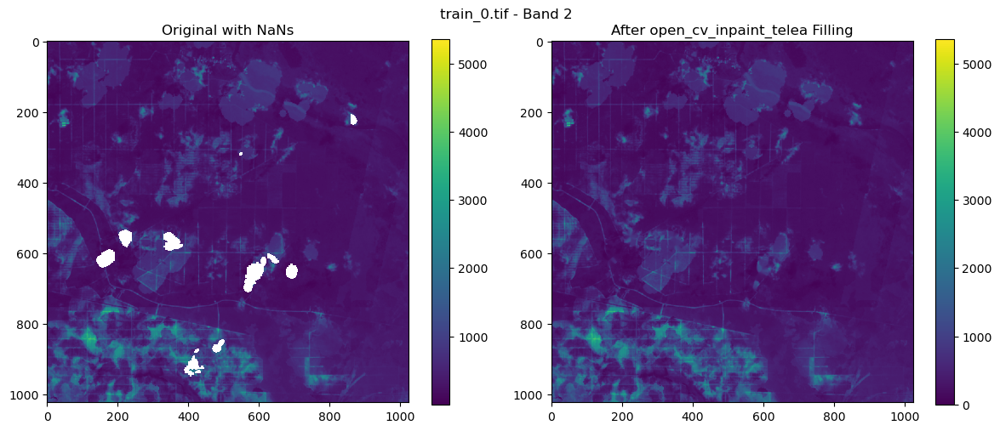

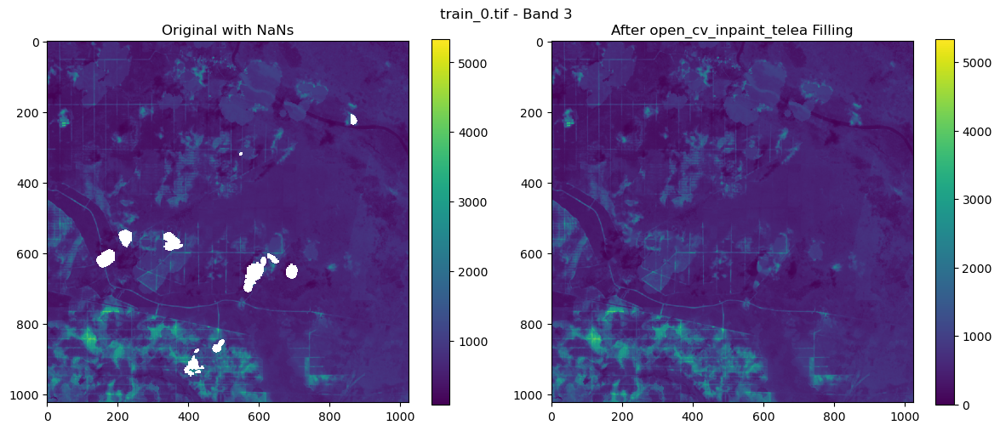

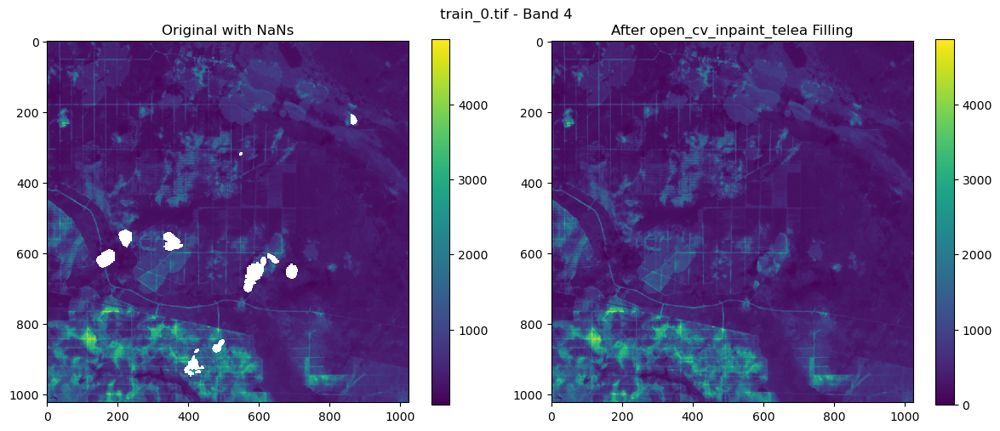

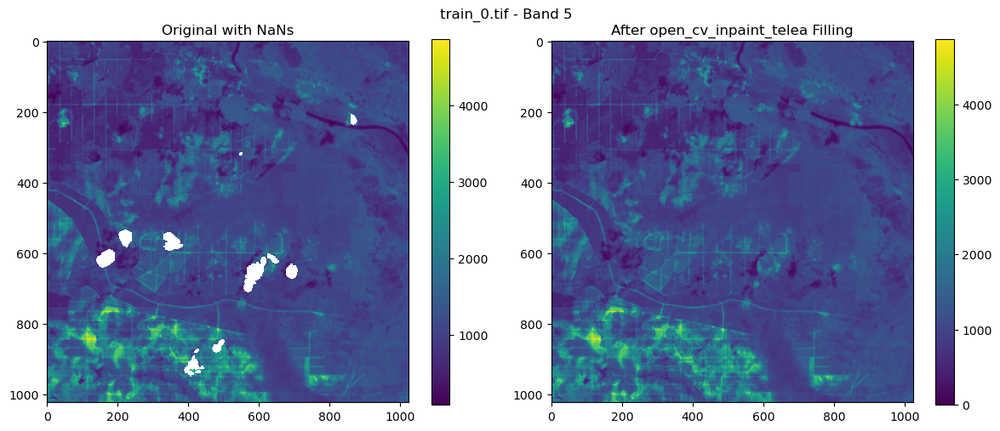

...

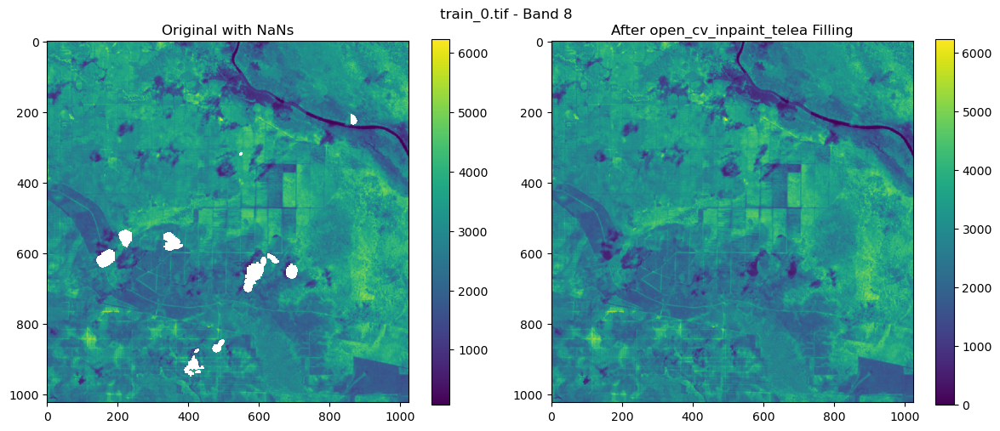

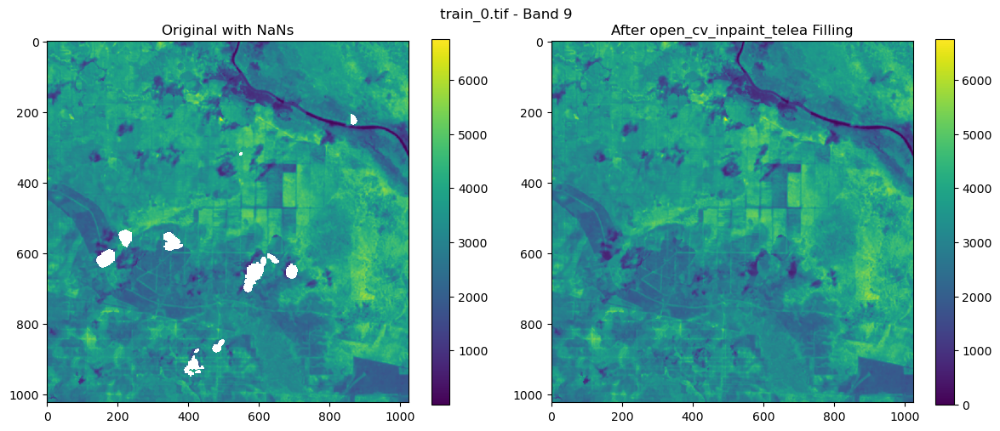

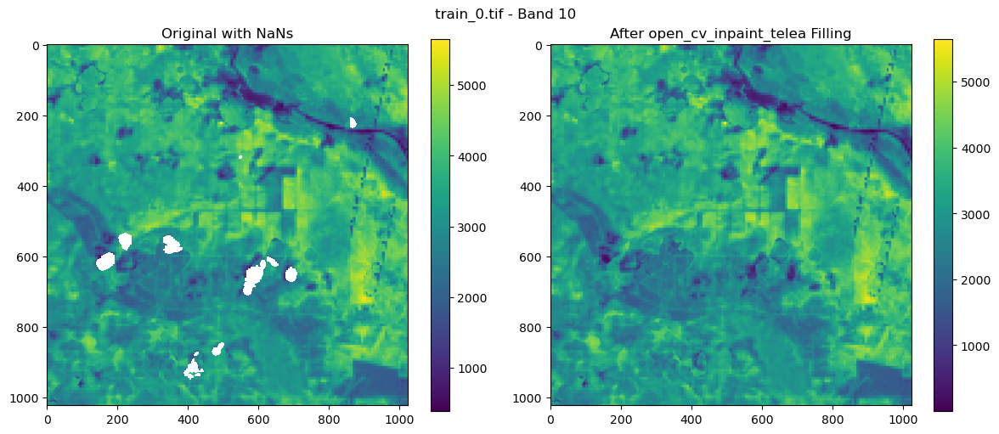

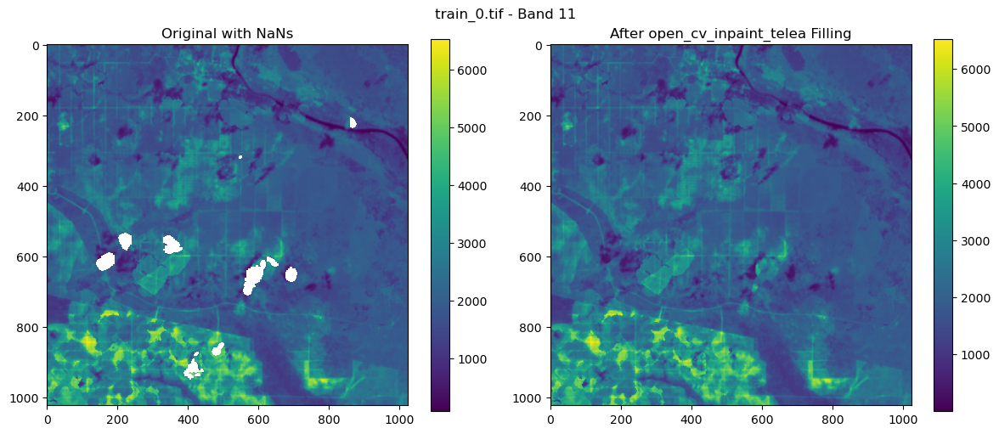

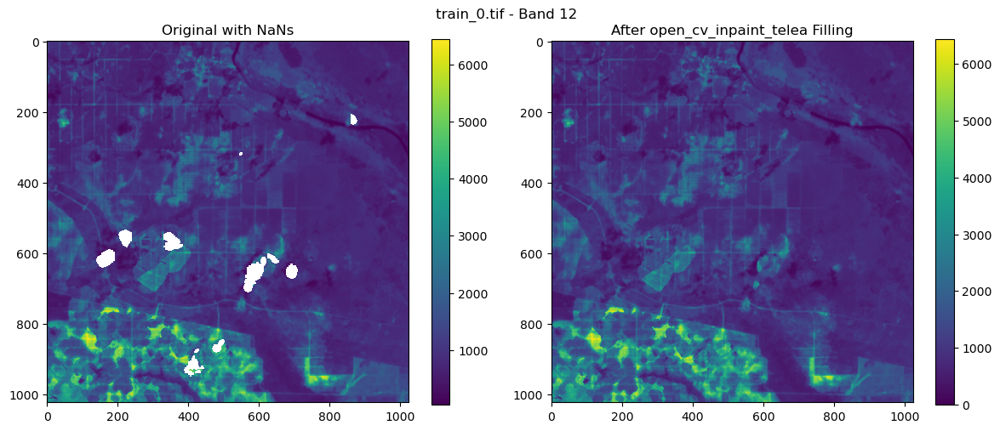

In [4]:
preprocessor.visualize_nan_filling(start=0, n=1)

Cv2 nan filling method works well


Prepare test dataset with same methods

In [7]:
test_preprocessor = PreProcessing(train_set=False, satlas=True, img_labels=False)
test_preprocessor.preprocess()
test_preprocessor.save_preprocessed(labels=False)

Processing evaluation_0.tif
Processing evaluation_1.tif
Processing evaluation_2.tif
Processing evaluation_3.tif
Processing evaluation_4.tif
Processing evaluation_5.tif
Processing evaluation_6.tif
Processing evaluation_7.tif
Processing evaluation_8.tif
Processing evaluation_9.tif
Processing evaluation_10.tif
Processing evaluation_11.tif
Processing evaluation_12.tif
Processing evaluation_13.tif
Processing evaluation_14.tif
Processing evaluation_15.tif
Processing evaluation_16.tif
Processing evaluation_17.tif
Processing evaluation_18.tif
Processing evaluation_19.tif
Processing evaluation_20.tif
Processing evaluation_21.tif
Processing evaluation_22.tif
Processing evaluation_23.tif
Processing evaluation_24.tif
Processing evaluation_25.tif
Processing evaluation_26.tif
Processing evaluation_27.tif
Processing evaluation_28.tif
Processing evaluation_29.tif
Processing evaluation_30.tif
Processing evaluation_31.tif
Processing evaluation_32.tif
Processing evaluation_33.tif
Processing evaluation_34